# CycleGAN with two-objective dualhead discriminator with bce and hinge losses 


Reference : https://www.kaggle.com/unfriendlyai/diffaugment-is-all-you-need

Why do we need such discriminator? We have only 300 Monet paintings and discriminator overfits quickly. Existing solutions are considered but they do not completely solve the problem of small amount of training data, which threatens to overfit the discriminator and the continious deterioration of the result. Successful results under such conditions are achieved by early stopping. A two-objective discriminator is proposed, which is expected to avoid the negative effects of overfitting the discriminator and the need for early stopping.







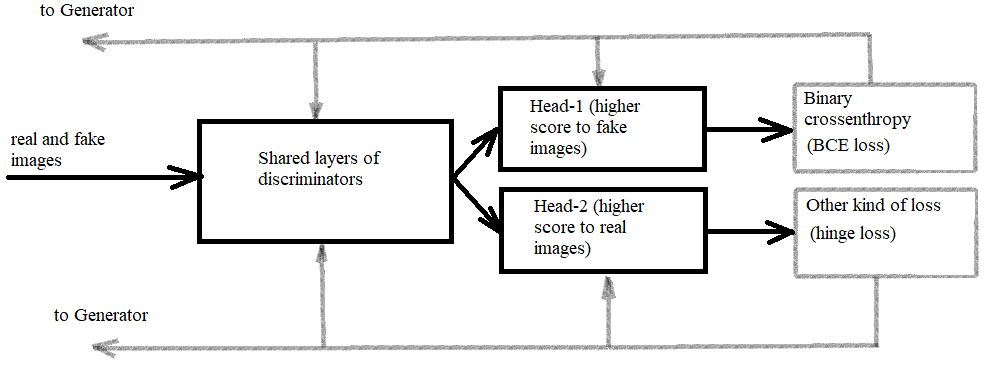

Main idea: shared layers are disturbed with two different losses and  discriminators cant overfit quickly

Related works: 

[Nguyen, T. et al. «Dual Discriminator Generative Adversarial Nets.» NIPS (2017).](https://arxiv.org/abs/1709.03831) - but discriminators have no shared layers there.

[Hoang, Q., Nguyen, T., Le, T., & Phung, D.Q. (2017). Multi-Generator Generative Adversarial Nets. ArXiv, abs/1708.02556](https://arxiv.org/abs/1708.02556) - discriminator and classificator have shared layers, but they are not both discriminators with different losses

In [1]:
BATCH_SIZE = 2

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa
import PIL
import matplotlib.pyplot as plt
import numpy as np
import re
try:
    from kaggle_datasets import KaggleDatasets
except:
    pass

In [2]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE
    
print(tf.__version__)

Number of replicas: 1
2.5.0


In [3]:


MONET_FILENAMES = tf.io.gfile.glob(str('data/monet_tfrec/*.tfrec'))
PHOTO_FILENAMES = tf.io.gfile.glob(str('data/photo_tfrec/*.tfrec'))


In [4]:
IMAGE_SIZE = [256, 256]

def decode_image(image):
    image = tf.image.decode_jpeg(image, channels=3)
    image = (tf.cast(image, tf.float32) / 127.5) - 1
    image = tf.reshape(image, [*IMAGE_SIZE, 3])
    return image

def read_tfrecord(example):
    tfrecord_format = {
        "image": tf.io.FixedLenFeature([], tf.string)
    }
    example = tf.io.parse_single_example(example, tfrecord_format)
    image = decode_image(example['image'])
    return image

In [5]:
def load_dataset(filenames):
    dataset = tf.data.TFRecordDataset(filenames)
    dataset = dataset.map(read_tfrecord, num_parallel_calls=AUTOTUNE)
    return dataset

monet_ds = load_dataset(MONET_FILENAMES).batch(1)
photo_ds = load_dataset(PHOTO_FILENAMES).batch(1)


fast_photo_ds = load_dataset(PHOTO_FILENAMES).batch(32*strategy.num_replicas_in_sync).prefetch(32)
fid_photo_ds = load_dataset(PHOTO_FILENAMES).take(1024).batch(32*strategy.num_replicas_in_sync).prefetch(32)
fid_monet_ds = load_dataset(MONET_FILENAMES).batch(32*strategy.num_replicas_in_sync).prefetch(32)

In [6]:
def get_gan_dataset(monet_files, photo_files, augment=None, repeat=True, shuffle=True, batch_size=1):

    monet_ds = load_dataset(monet_files)
    photo_ds = load_dataset(photo_files)
    
    if augment:
        monet_ds = monet_ds.map(augment, num_parallel_calls=AUTOTUNE)
        photo_ds = photo_ds.map(augment, num_parallel_calls=AUTOTUNE)

    if repeat:
        monet_ds = monet_ds.repeat()
        photo_ds = photo_ds.repeat()
        
#     if shuffle:
#         monet_ds = monet_ds.shuffle(2048)
#         photo_ds = photo_ds.shuffle(2048)
        
    monet_ds = monet_ds.batch(batch_size, drop_remainder=True)
    photo_ds = photo_ds.batch(batch_size, drop_remainder=True)
#     monet_ds = monet_ds.cache()
#     photo_ds = photo_ds.cache()
    #monet_ds = monet_ds.prefetch(AUTOTUNE)
    monet_ds = monet_ds.prefetch(BATCH_SIZE)
    photo_ds = photo_ds.prefetch(BATCH_SIZE)
    
    gan_ds = tf.data.Dataset.zip((monet_ds, photo_ds))
    
    return gan_ds



In [7]:
final_dataset = get_gan_dataset(MONET_FILENAMES, PHOTO_FILENAMES, augment=None, repeat=True, shuffle=True, batch_size=BATCH_SIZE)

In [10]:
OUTPUT_CHANNELS = 3

def down_sample(filters, size, apply_instancenorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    layer = keras.Sequential()
    layer.add(layers.Conv2D(filters, size, strides=2, padding='same', kernel_initializer=initializer, use_bias=False))

    if apply_instancenorm:
        layer.add(tfa.layers.InstanceNormalization(gamma_initializer=gamma_init))

    layer.add(layers.LeakyReLU())

    return layer

In [11]:
def up_sample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    layer = keras.Sequential()
    layer.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same', kernel_initializer=initializer,use_bias=False))
    layer.add(tfa.layers.InstanceNormalization(gamma_initializer=gamma_init))

    if apply_dropout:
        layer.add(layers.Dropout(0.5))

    layer.add(layers.ReLU())

    return layer

In [12]:
def Generator():
    inputs = layers.Input(shape=[256,256,3])
    down_stack = [
        down_sample(64, 4, apply_instancenorm=False),# (size, 128, 128, 64)
        down_sample(128, 4),                         # (size, 64, 64, 128)
        down_sample(256, 4),                         # (size, 32, 32, 256)
        down_sample(512, 4),                         # (size, 16, 16, 512)
        down_sample(512, 4),                         # (size, 8, 8, 512)
        down_sample(512, 4),                         # (size, 4, 4, 512)
        down_sample(512, 4),                         # (size, 2, 2, 512)
        down_sample(512, 4),                         # (size, 1, 1, 512)
    ]

    up_stack = [
        up_sample(512, 4, apply_dropout=True),       # (size, 2, 2, 1024)
        up_sample(512, 4, apply_dropout=True),       # (size, 4, 4, 1024)
        up_sample(512, 4, apply_dropout=True),       # (size, 8, 8, 1024)
        up_sample(512, 4),                           # (size, 16, 16, 1024)
        up_sample(256, 4),                           # (size, 32, 32, 512)
        up_sample(128, 4),                           # (size, 64, 64, 256)
        up_sample(64, 4),                            # (size, 128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = layers.Conv2DTranspose(3, 4, strides=2, padding='same', kernel_initializer=initializer, activation='tanh') 
    # (size, 256, 256, 3)

    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])

    x = last(x)

    return keras.Model(inputs=inputs, outputs=x)

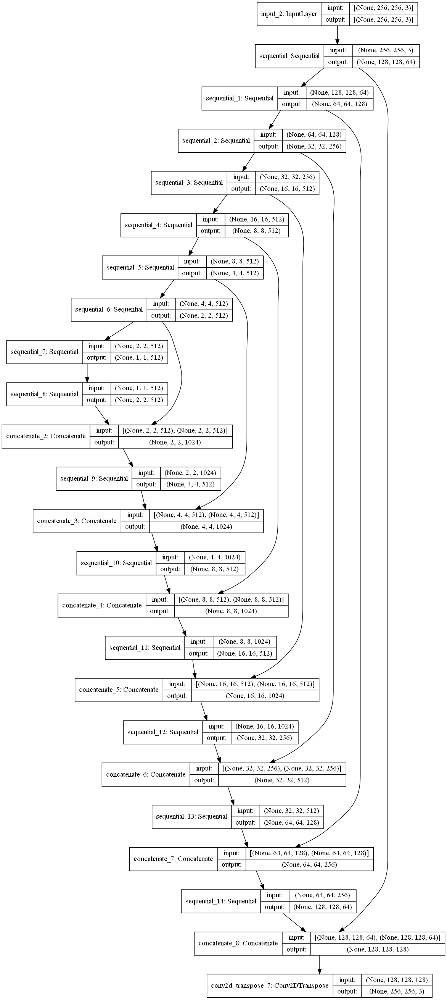

In [27]:
tf.keras.utils.plot_model(monet_generator,  show_shapes=True)

# Headless discriminator (shared part)

In [13]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
    
    inp = layers.Input(shape=[256, 256, 3], name='input_image')
    x = inp
    
    down1 = down_sample(64, 4, False)(x)       # (size, 128, 128, 64)
    down2 = down_sample(128, 4)(down1)         # (size, 64, 64, 128)
    down3 = down_sample(256, 4)(down2)         # (size, 32, 32, 256)

    zero_pad1 = layers.ZeroPadding2D()(down3) # (size, 34, 34, 256)
    conv = layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer, use_bias=False)(zero_pad1) # (size, 31, 31, 512)

    norm1 = tfa.layers.InstanceNormalization(gamma_initializer=gamma_init)(conv)
    leaky_relu = layers.LeakyReLU()(norm1)
    zero_pad2 = layers.ZeroPadding2D()(leaky_relu) # (size, 33, 33, 512)

    return tf.keras.Model(inputs=inp, outputs=zero_pad2)

# Head for two-objective discriminator for Monet

In [14]:
def DHead():
    initializer = tf.random_normal_initializer(0., 0.02)
    
    inp = layers.Input(shape=[33, 33, 512], name='input_image')
    x = inp
    
    last = layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(x) # (size, 30, 30, 1)

    return tf.keras.Model(inputs=inp, outputs=last)

# Discriminator for Photos (unchanged)

In [15]:
def DiscriminatorP():
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
    
    inp = layers.Input(shape=[256, 256, 3], name='input_image')
    x = inp
    
    down1 = down_sample(64, 4, False)(x)       # (size, 128, 128, 64)
    down2 = down_sample(128, 4)(down1)         # (size, 64, 64, 128)
    down3 = down_sample(256, 4)(down2)         # (size, 32, 32, 256)

    zero_pad1 = layers.ZeroPadding2D()(down3) # (size, 34, 34, 256)
    conv = layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer, use_bias=False)(zero_pad1) # (size, 31, 31, 512)

    norm1 = tfa.layers.InstanceNormalization(gamma_initializer=gamma_init)(conv)
    leaky_relu = layers.LeakyReLU()(norm1)
    zero_pad2 = layers.ZeroPadding2D()(leaky_relu) # (size, 33, 33, 512)
    last = layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (size, 30, 30, 1)

    return tf.keras.Model(inputs=inp, outputs=last)

In [16]:
with strategy.scope():
    monet_generator = Generator() # transforms photos to Monet-esque paintings
    photo_generator = Generator() # transforms Monet paintings to be more like photos

    monet_discriminator = Discriminator() # differentiates real Monet paintings and generated Monet paintings
    photo_discriminator = DiscriminatorP() # differentiates real photos and generated photos
    dHead1 = DHead() # Head for BCE
    dHead2 = DHead() # Head for hinge loss


# CycleGAN with DiffAugment and two-objective discriminator

In [17]:
class CycleGan(keras.Model):
    def __init__(
        self,
        monet_generator,
        photo_generator,
        monet_discriminator,
        photo_discriminator,
        dhead1,        
        dhead2,        
        lambda_cycle=3,
        lambda_id=3,
    ):
        super(CycleGan, self).__init__()
        self.m_gen = monet_generator
        self.p_gen = photo_generator
        self.m_disc = monet_discriminator
        self.p_disc = photo_discriminator
        self.lambda_cycle = lambda_cycle
        self.lambda_id = lambda_id
        self.dhead1 = dhead1
        self.dhead2 = dhead2
        
    def compile(
        self,
        m_gen_optimizer,
        p_gen_optimizer,
        m_disc_optimizer,
        p_disc_optimizer,
        gen_loss_fn1,
        gen_loss_fn2,
        disc_loss_fn1,
        disc_loss_fn2,
        cycle_loss_fn,
        identity_loss_fn,
        aug_fn,

    ):
        super(CycleGan, self).compile()
        self.m_gen_optimizer = m_gen_optimizer
        self.p_gen_optimizer = p_gen_optimizer
        self.m_disc_optimizer = m_disc_optimizer
        self.p_disc_optimizer = p_disc_optimizer
        self.gen_loss_fn1 = gen_loss_fn1
        self.gen_loss_fn2 = gen_loss_fn2
        self.disc_loss_fn1 = disc_loss_fn1
        self.disc_loss_fn2 = disc_loss_fn2
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn
        self.aug_fn = aug_fn

        self.step_num = 0
        
    def train_step(self, batch_data):
        real_monet, real_photo = batch_data
        batch_size = tf.shape(real_monet)[0]
        with tf.GradientTape(persistent=True) as tape:
        
            # photo to monet back to photo
            fake_monet = self.m_gen(real_photo, training=True)
            cycled_photo = self.p_gen(fake_monet, training=True)

            # monet to photo back to monet
            fake_photo = self.p_gen(real_monet, training=True)
            cycled_monet = self.m_gen(fake_photo, training=True)

            # generating itself
            same_monet = self.m_gen(real_monet, training=True)
            same_photo = self.p_gen(real_photo, training=True)

            
            
            # Diffaugment
            both_monet = tf.concat([real_monet, fake_monet], axis=0)            
            
            aug_monet = self.aug_fn(both_monet)
            
            aug_real_monet = aug_monet[:batch_size]
            aug_fake_monet = aug_monet[batch_size:]
            
            
            # two-objective discriminator
            disc_fake_monet1 = self.dhead1(self.m_disc(aug_fake_monet, training=True), training=True)
            disc_real_monet1 = self.dhead1(self.m_disc(aug_real_monet, training=True), training=True)
            disc_fake_monet2 = self.dhead2(self.m_disc(aug_fake_monet, training=True), training=True)
            disc_real_monet2 = self.dhead2(self.m_disc(aug_real_monet, training=True), training=True)

            monet_gen_loss1 = self.gen_loss_fn1(disc_fake_monet1) 
            monet_head_loss1 = self.disc_loss_fn1(disc_real_monet1, disc_fake_monet1)
            monet_gen_loss2 = self.gen_loss_fn2(disc_fake_monet2)
            monet_head_loss2 = self.disc_loss_fn2(disc_real_monet2, disc_fake_monet2)



            monet_gen_loss = (monet_gen_loss1 + monet_gen_loss2) * 0.4
            monet_disc_loss = monet_head_loss1 + monet_head_loss2


           
            
            # discriminator used to check, inputing real images

            disc_real_photo = self.p_disc(real_photo, training=True)
            # discriminator used to check, inputing fake images

            disc_fake_photo = self.p_disc(fake_photo, training=True)

            # evaluates generator loss

            photo_gen_loss = self.gen_loss_fn1(disc_fake_photo)
            
            # evaluates discriminator loss

            photo_disc_loss = self.disc_loss_fn1(disc_real_photo, disc_fake_photo)


            # evaluates total generator loss
            total_cycle_loss = self.cycle_loss_fn(real_monet, cycled_monet, self.lambda_cycle/ tf.cast(batch_size,tf.float32)) + self.cycle_loss_fn(real_photo, cycled_photo, self.lambda_cycle/ tf.cast(batch_size,tf.float32))

            # evaluates total generator loss
            total_monet_gen_loss = monet_gen_loss + total_cycle_loss +  self.identity_loss_fn(real_monet, same_monet, self.lambda_id / tf.cast(batch_size,tf.float32))
            total_photo_gen_loss = photo_gen_loss + total_cycle_loss + self.identity_loss_fn(real_photo, same_photo, self.lambda_id/ tf.cast(batch_size,tf.float32))



        # Calculate the gradients for generator and discriminator
        monet_generator_gradients = tape.gradient(total_monet_gen_loss,
                                                  self.m_gen.trainable_variables)
        photo_generator_gradients = tape.gradient(total_photo_gen_loss,
                                                  self.p_gen.trainable_variables)

        monet_discriminator_gradients = tape.gradient(monet_disc_loss,
                                                      self.m_disc.trainable_variables)
        photo_discriminator_gradients = tape.gradient(photo_disc_loss,
                                                      self.p_disc.trainable_variables)
        

        # Heads gradients
        monet_head_gradients = tape.gradient(monet_head_loss1,
                                                      self.dhead1.trainable_variables)

        self.m_disc_optimizer.apply_gradients(zip(monet_head_gradients,
                                                  self.dhead1.trainable_variables))       

        monet_head_gradients = tape.gradient(monet_head_loss2,
                                                      self.dhead2.trainable_variables)
        self.m_disc_optimizer.apply_gradients(zip(monet_head_gradients,
                                                  self.dhead2.trainable_variables))     
        
        
        
        # Apply the gradients to the optimizer
        self.m_gen_optimizer.apply_gradients(zip(monet_generator_gradients,
                                                 self.m_gen.trainable_variables))

        self.p_gen_optimizer.apply_gradients(zip(photo_generator_gradients,
                                                 self.p_gen.trainable_variables))

        self.m_disc_optimizer.apply_gradients(zip(monet_discriminator_gradients,
                                                  self.m_disc.trainable_variables))

        self.p_disc_optimizer.apply_gradients(zip(photo_discriminator_gradients,
                                                  self.p_disc.trainable_variables))
        
        return {
            "monet_head_loss1": monet_head_loss1, 
            "monet_head_loss2": monet_head_loss2, 
            "disc_real_monet": disc_real_monet1, 
            "disc_fake_monet": disc_fake_monet1, 
            "disc_real_monet2": disc_real_monet2, 
            "disc_fake_monet2": disc_fake_monet2, 
            "monet_gen_loss": monet_gen_loss, 
            "photo_disc_loss": photo_disc_loss, 
            }


In [18]:
with strategy.scope(): # for TPU

    def discriminator_loss1(real, generated):
        real_loss = tf.math.minimum(tf.zeros_like(real), real-tf.ones_like(real))

        generated_loss = tf.math.minimum(tf.zeros_like(generated), -generated-tf.ones_like(generated))

        total_disc_loss = real_loss + generated_loss

        return tf.reduce_mean(-total_disc_loss * 0.5)

    def discriminator_loss2(real, generated):
        generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.ones_like(generated), generated)
        real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.zeros_like(real), real)
        total_disc_loss = real_loss + generated_loss

        return tf.reduce_mean(total_disc_loss * 0.5)



In [19]:
with strategy.scope():
    def generator_loss1(generated):
        return  tf.reduce_mean(-generated)

    def generator_loss2(generated):
        return tf.reduce_mean(tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.zeros_like(generated), generated))

In [20]:
with strategy.scope():
    def calc_cycle_loss(real_image, cycled_image, LAMBDA):
        loss1 = tf.reduce_sum(tf.abs(real_image - cycled_image))

        return LAMBDA * loss1 * 0.0000152587890625

In [21]:
with strategy.scope():
    def identity_loss(real_image, same_image, LAMBDA):
        loss = tf.reduce_sum(tf.abs(real_image - same_image))
        return LAMBDA * 0.5 * loss * 0.0000152587890625

In [22]:
with strategy.scope():
# Differentiable Augmentation for Data-Efficient GAN Training
# Shengyu Zhao, Zhijian Liu, Ji Lin, Jun-Yan Zhu, and Song Han
# https://arxiv.org/pdf/2006.10738
# from https://github.com/mit-han-lab/data-efficient-gans/blob/master/DiffAugment_tf.py



    def DiffAugment(x, policy='', channels_first=False):
        if policy:
            if channels_first:
                x = tf.transpose(x, [0, 2, 3, 1])
            for p in policy.split(','):
                for f in AUGMENT_FNS[p]:
                    x = f(x)
            if channels_first:
                x = tf.transpose(x, [0, 3, 1, 2])
        return x


    def rand_brightness(x):
        magnitude = tf.random.uniform([tf.shape(x)[0], 1, 1, 1]) - 0.5
        x = x + magnitude
        return x


    def rand_saturation(x):
        magnitude = tf.random.uniform([tf.shape(x)[0], 1, 1, 1]) * 2
        x_mean = tf.reduce_sum(x, axis=3, keepdims=True) * 0.3333333333333333333
        x = (x - x_mean) * magnitude + x_mean
        return x


    def rand_contrast(x):
        magnitude = tf.random.uniform([tf.shape(x)[0], 1, 1, 1]) + 0.5
        x_mean = tf.reduce_sum(x, axis=[1, 2, 3], keepdims=True) * 5.086e-6
        x = (x - x_mean) * magnitude + x_mean
        return x

    def rand_translation(x, ratio=0.125):
        batch_size = tf.shape(x)[0]
        image_size = tf.shape(x)[1:3]
        shift = tf.cast(tf.cast(image_size, tf.float32) * ratio + 0.5, tf.int32)
        translation_x = tf.random.uniform([batch_size, 1], -shift[0], shift[0] + 1, dtype=tf.int32)
        translation_y = tf.random.uniform([batch_size, 1], -shift[1], shift[1] + 1, dtype=tf.int32)
        grid_x = tf.clip_by_value(tf.expand_dims(tf.range(image_size[0], dtype=tf.int32), 0) + translation_x + 1, 0, image_size[0] + 1)
        grid_y = tf.clip_by_value(tf.expand_dims(tf.range(image_size[1], dtype=tf.int32), 0) + translation_y + 1, 0, image_size[1] + 1)
        x = tf.gather_nd(tf.pad(x, [[0, 0], [1, 1], [0, 0], [0, 0]]), tf.expand_dims(grid_x, -1), batch_dims=1)
        x = tf.transpose(tf.gather_nd(tf.pad(tf.transpose(x, [0, 2, 1, 3]), [[0, 0], [1, 1], [0, 0], [0, 0]]), tf.expand_dims(grid_y, -1), batch_dims=1), [0, 2, 1, 3])
        return x


    def rand_cutout(x, ratio=0.5):
        batch_size = tf.shape(x)[0]
        image_size = tf.shape(x)[1:3]
        cutout_size = tf.cast(tf.cast(image_size, tf.float32) * ratio + 0.5, tf.int32)
        offset_x = tf.random.uniform([tf.shape(x)[0], 1, 1], maxval=image_size[0] + (1 - cutout_size[0] % 2), dtype=tf.int32)
        offset_y = tf.random.uniform([tf.shape(x)[0], 1, 1], maxval=image_size[1] + (1 - cutout_size[1] % 2), dtype=tf.int32)
        grid_batch, grid_x, grid_y = tf.meshgrid(tf.range(batch_size, dtype=tf.int32), tf.range(cutout_size[0], dtype=tf.int32), tf.range(cutout_size[1], dtype=tf.int32), indexing='ij')
        cutout_grid = tf.stack([grid_batch, grid_x + offset_x - cutout_size[0] // 2, grid_y + offset_y - cutout_size[1] // 2], axis=-1)
        mask_shape = tf.stack([batch_size, image_size[0], image_size[1]])
        cutout_grid = tf.maximum(cutout_grid, 0)
        cutout_grid = tf.minimum(cutout_grid, tf.reshape(mask_shape - 1, [1, 1, 1, 3]))
        mask = tf.maximum(1 - tf.scatter_nd(cutout_grid, tf.ones([batch_size, cutout_size[0], cutout_size[1]], dtype=tf.float32), mask_shape), 0)
        x = x * tf.expand_dims(mask, axis=3)
        return x


    AUGMENT_FNS = {
        'color': [rand_brightness, rand_saturation, rand_contrast],
        'translation': [rand_translation],
        'cutout': [rand_cutout],
}
    def aug_fn(image):
        return DiffAugment(image,"color,translation,cutout")

In [23]:
with strategy.scope():
    monet_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

    monet_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [24]:
with strategy.scope():
    cycle_gan_model = CycleGan(
        monet_generator, photo_generator, monet_discriminator, photo_discriminator, dHead1,  dHead2
    )



# 30 epochs with lr 2e-4

In [25]:
with strategy.scope():

    cycle_gan_model.compile(
        m_gen_optimizer = monet_generator_optimizer,
        p_gen_optimizer = photo_generator_optimizer,
        m_disc_optimizer = monet_discriminator_optimizer,
        p_disc_optimizer = photo_discriminator_optimizer,
        gen_loss_fn1 = generator_loss1,
        gen_loss_fn2 = generator_loss2,
        disc_loss_fn1 = discriminator_loss1,
        disc_loss_fn2 = discriminator_loss2,
        cycle_loss_fn = calc_cycle_loss,
        identity_loss_fn = identity_loss,
        aug_fn = aug_fn ,


    )

In [26]:
examples = photo_ds.batch(4)
example_photo = next(iter(examples))



    

class ShowExamples(keras.callbacks.Callback):

    def on_epoch_end(self, epoch, logs=None):
        print("5 generated examples")
        plt.figure(figsize=(12,6))
        for i in range(4):
            plt.subplot(250+i+1)
            plt.title('Real photo '+str(i+1))
            plt.imshow(example_photo[i][0] * 0.5 + 0.5)
            plt.subplot(250+i+6)
            plt.title('Fake Monet '+str(i+1))
            g=monet_generator(example_photo[i],training=False)[0].numpy()
            g=(g * 127.5 + 127.5).astype(np.uint8)
            plt.imshow(g)
            im = PIL.Image.fromarray(g)
            im.save("train_examples/aug/" + str(epoch)+str(i) + ".jpg")
            
        plt.show()

# 20 epochs with lr 1e-4

In [28]:
with strategy.scope():
    monet_generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)
    photo_generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

    monet_discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)
    photo_discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

In [29]:
with strategy.scope():

    cycle_gan_model.compile(
        m_gen_optimizer = monet_generator_optimizer,
        p_gen_optimizer = photo_generator_optimizer,
        m_disc_optimizer = monet_discriminator_optimizer,
        p_disc_optimizer = photo_discriminator_optimizer,
        gen_loss_fn1 = generator_loss1,
        gen_loss_fn2 = generator_loss2,
        disc_loss_fn1 = discriminator_loss1,
        disc_loss_fn2 = discriminator_loss2,
        cycle_loss_fn = calc_cycle_loss,
        identity_loss_fn = identity_loss,
        aug_fn = aug_fn ,
    )

Epoch 1/20
296/296 [==============================] - 220s 743ms/step - monet_head_loss1: 0.8991 - monet_head_loss2: 0.6742 - disc_real_monet: 0.1243 - disc_fake_monet: -0.1196 - disc_real_monet2: -0.0569 - disc_fake_monet2: 0.0556 - monet_gen_loss: 0.3400 - photo_disc_loss: 0.8307
5 generated examples


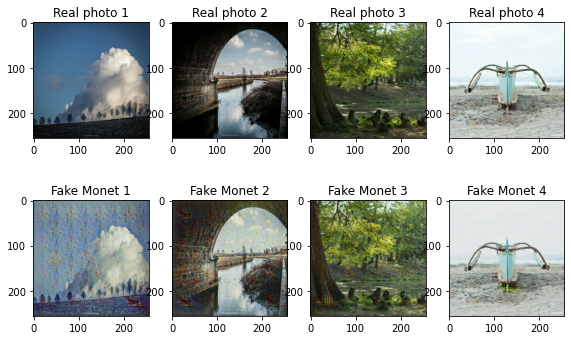

Epoch 2/20
296/296 [==============================] - 220s 743ms/step - monet_head_loss1: 0.9270 - monet_head_loss2: 0.6817 - disc_real_monet: 0.1114 - disc_fake_monet: -0.0686 - disc_real_monet2: -0.0399 - disc_fake_monet2: 0.0444 - monet_gen_loss: 0.3176 - photo_disc_loss: 0.8529
5 generated examples


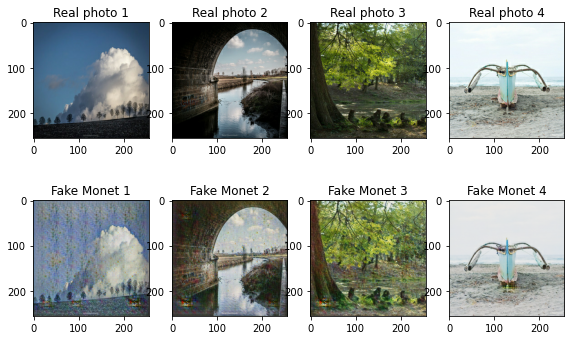

Epoch 3/20
296/296 [==============================] - 219s 741ms/step - monet_head_loss1: 0.9512 - monet_head_loss2: 0.6873 - disc_real_monet: 0.0624 - disc_fake_monet: -0.0603 - disc_real_monet2: -0.0275 - disc_fake_monet2: 0.0305 - monet_gen_loss: 0.3110 - photo_disc_loss: 0.8846
5 generated examples


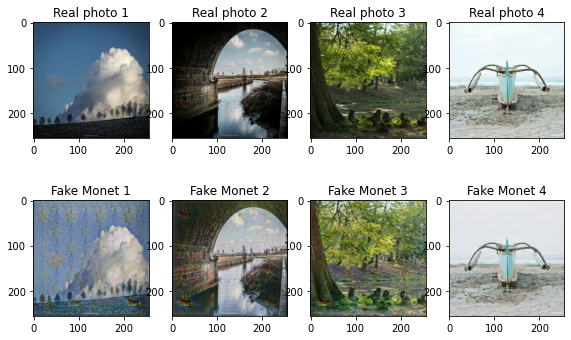

Epoch 4/20
296/296 [==============================] - 218s 737ms/step - monet_head_loss1: 0.9333 - monet_head_loss2: 0.6827 - disc_real_monet: 0.0542 - disc_fake_monet: -0.1063 - disc_real_monet2: -0.0350 - disc_fake_monet2: 0.0405 - monet_gen_loss: 0.3313 - photo_disc_loss: 0.8453
5 generated examples


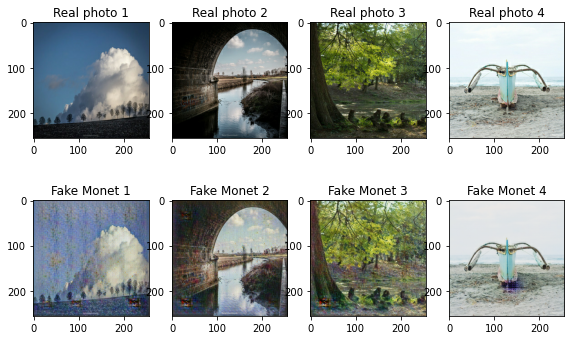

Epoch 5/20
296/296 [==============================] - 220s 743ms/step - monet_head_loss1: 0.9048 - monet_head_loss2: 0.6763 - disc_real_monet: 0.1143 - disc_fake_monet: -0.1202 - disc_real_monet2: -0.0576 - disc_fake_monet2: 0.0525 - monet_gen_loss: 0.3401 - photo_disc_loss: 0.8361
5 generated examples


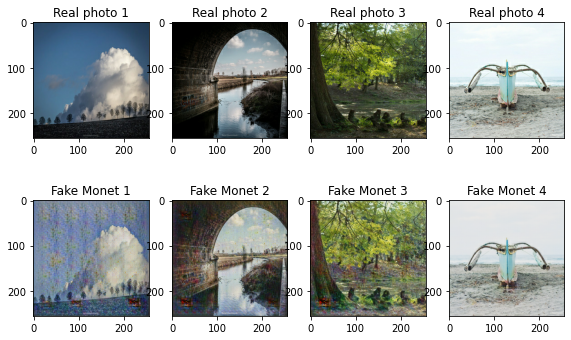

Epoch 6/20
296/296 [==============================] - 219s 739ms/step - monet_head_loss1: 0.9508 - monet_head_loss2: 0.6868 - disc_real_monet: 0.0690 - disc_fake_monet: -0.0516 - disc_real_monet2: -0.0293 - disc_fake_monet2: 0.0304 - monet_gen_loss: 0.3074 - photo_disc_loss: 0.8626
5 generated examples


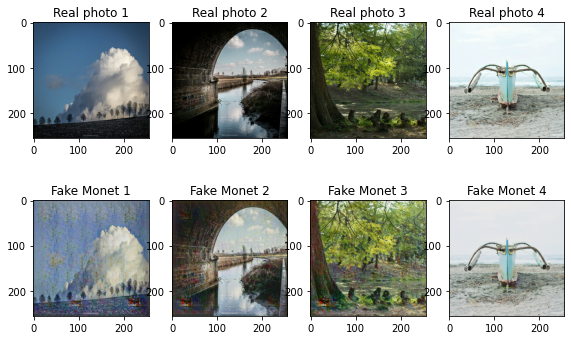

Epoch 7/20
296/296 [==============================] - 219s 739ms/step - monet_head_loss1: 0.9138 - monet_head_loss2: 0.6780 - disc_real_monet: 0.1205 - disc_fake_monet: -0.0867 - disc_real_monet2: -0.0469 - disc_fake_monet2: 0.0514 - monet_gen_loss: 0.3262 - photo_disc_loss: 0.8458
5 generated examples


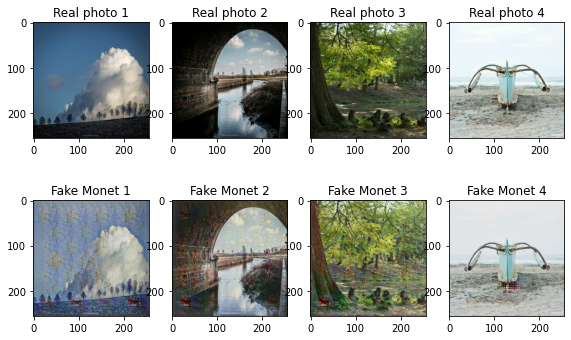

Epoch 8/20
296/296 [==============================] - 218s 737ms/step - monet_head_loss1: 0.9558 - monet_head_loss2: 0.6881 - disc_real_monet: 0.0688 - disc_fake_monet: -0.0557 - disc_real_monet2: -0.0268 - disc_fake_monet2: 0.0343 - monet_gen_loss: 0.3106 - photo_disc_loss: 0.8664
5 generated examples


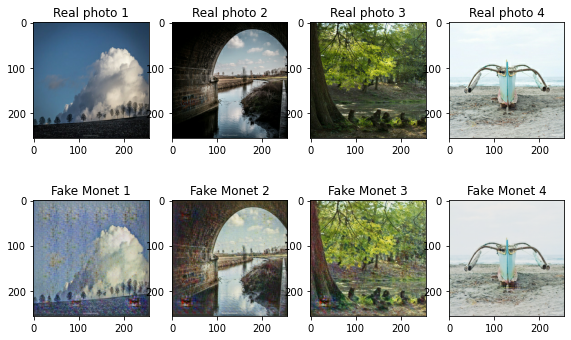

Epoch 9/20
296/296 [==============================] - 219s 741ms/step - monet_head_loss1: 0.9581 - monet_head_loss2: 0.6884 - disc_real_monet: 0.0259 - disc_fake_monet: -0.0787 - disc_real_monet2: -0.0235 - disc_fake_monet2: 0.0271 - monet_gen_loss: 0.3174 - photo_disc_loss: 0.8907
5 generated examples


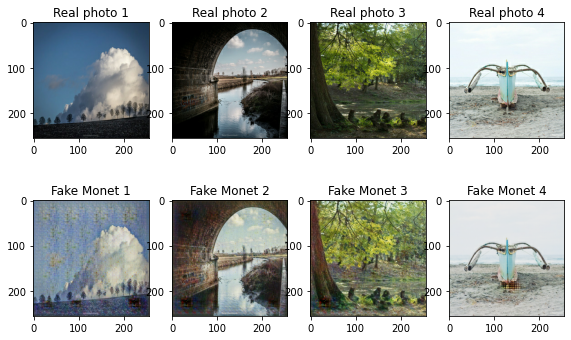

Epoch 10/20
296/296 [==============================] - 219s 740ms/step - monet_head_loss1: 0.9243 - monet_head_loss2: 0.6803 - disc_real_monet: 0.0854 - disc_fake_monet: -0.0913 - disc_real_monet2: -0.0378 - disc_fake_monet2: 0.0460 - monet_gen_loss: 0.3264 - photo_disc_loss: 0.8798
5 generated examples


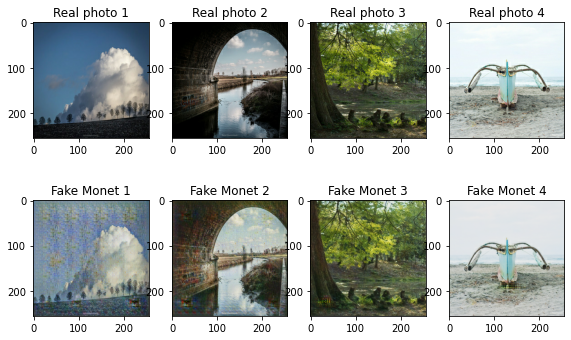

Epoch 11/20
296/296 [==============================] - 219s 741ms/step - monet_head_loss1: 0.9565 - monet_head_loss2: 0.6879 - disc_real_monet: 0.0814 - disc_fake_monet: -0.0232 - disc_real_monet2: -0.0284 - disc_fake_monet2: 0.0226 - monet_gen_loss: 0.2942 - photo_disc_loss: 0.8752
5 generated examples


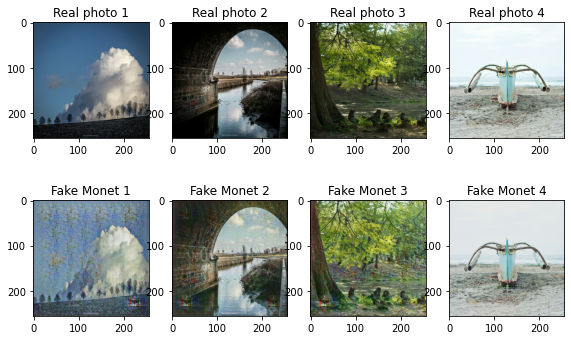

Epoch 12/20
296/296 [==============================] - 228s 771ms/step - monet_head_loss1: 0.9304 - monet_head_loss2: 0.6824 - disc_real_monet: 0.0792 - disc_fake_monet: -0.0850 - disc_real_monet2: -0.0341 - disc_fake_monet2: 0.0426 - monet_gen_loss: 0.3233 - photo_disc_loss: 0.8965
5 generated examples


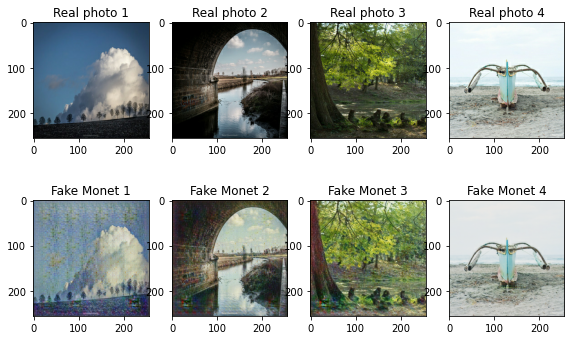

Epoch 13/20
296/296 [==============================] - 230s 777ms/step - monet_head_loss1: 0.9520 - monet_head_loss2: 0.6871 - disc_real_monet: 0.0820 - disc_fake_monet: -0.0386 - disc_real_monet2: -0.0296 - disc_fake_monet2: 0.0273 - monet_gen_loss: 0.3016 - photo_disc_loss: 0.8743
5 generated examples


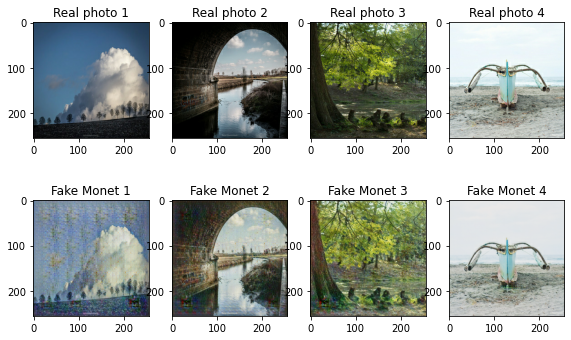

Epoch 14/20
296/296 [==============================] - 230s 777ms/step - monet_head_loss1: 0.9412 - monet_head_loss2: 0.6844 - disc_real_monet: 0.0910 - disc_fake_monet: -0.0480 - disc_real_monet2: -0.0310 - disc_fake_monet2: 0.0343 - monet_gen_loss: 0.3064 - photo_disc_loss: 0.9007
5 generated examples


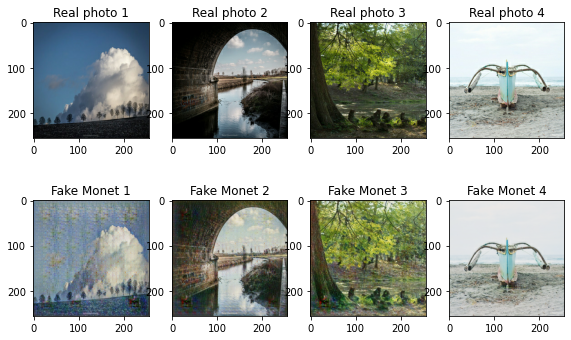

Epoch 15/20
296/296 [==============================] - 229s 774ms/step - monet_head_loss1: 0.9319 - monet_head_loss2: 0.6823 - disc_real_monet: 0.0753 - disc_fake_monet: -0.0820 - disc_real_monet2: -0.0333 - disc_fake_monet2: 0.0395 - monet_gen_loss: 0.3210 - photo_disc_loss: 0.9149
5 generated examples


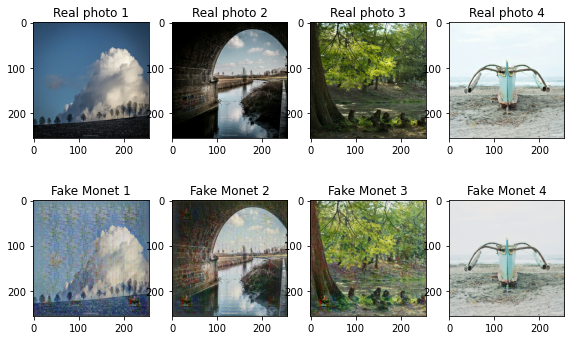

Epoch 16/20
296/296 [==============================] - 223s 753ms/step - monet_head_loss1: 0.9449 - monet_head_loss2: 0.6856 - disc_real_monet: 0.0508 - disc_fake_monet: -0.0817 - disc_real_monet2: -0.0302 - disc_fake_monet2: 0.0321 - monet_gen_loss: 0.3196 - photo_disc_loss: 0.8956
5 generated examples


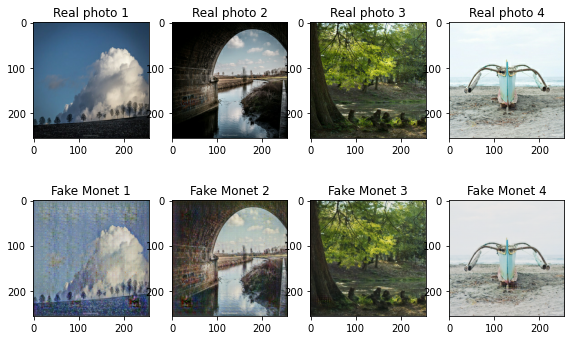

Epoch 17/20
296/296 [==============================] - 221s 748ms/step - monet_head_loss1: 0.9247 - monet_head_loss2: 0.6807 - disc_real_monet: 0.1114 - disc_fake_monet: -0.0750 - disc_real_monet2: -0.0461 - disc_fake_monet2: 0.0408 - monet_gen_loss: 0.3193 - photo_disc_loss: 0.8711
5 generated examples


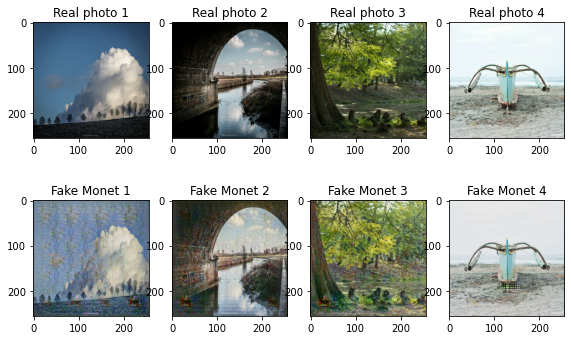

Epoch 18/20
296/296 [==============================] - 218s 737ms/step - monet_head_loss1: 0.9373 - monet_head_loss2: 0.6836 - disc_real_monet: 0.0756 - disc_fake_monet: -0.0772 - disc_real_monet2: -0.0335 - disc_fake_monet2: 0.0384 - monet_gen_loss: 0.3192 - photo_disc_loss: 0.8518
5 generated examples


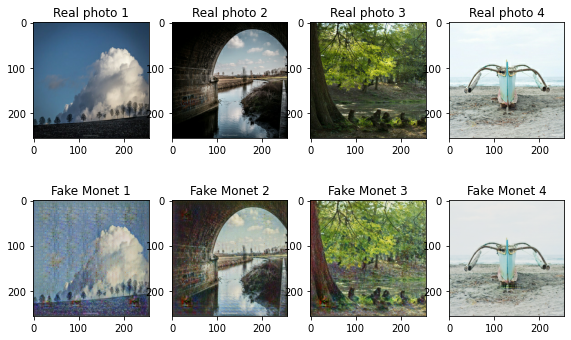

Epoch 19/20
296/296 [==============================] - 219s 738ms/step - monet_head_loss1: 0.9448 - monet_head_loss2: 0.6857 - disc_real_monet: 0.0511 - disc_fake_monet: -0.0843 - disc_real_monet2: -0.0295 - disc_fake_monet2: 0.0329 - monet_gen_loss: 0.3209 - photo_disc_loss: 0.8616
5 generated examples


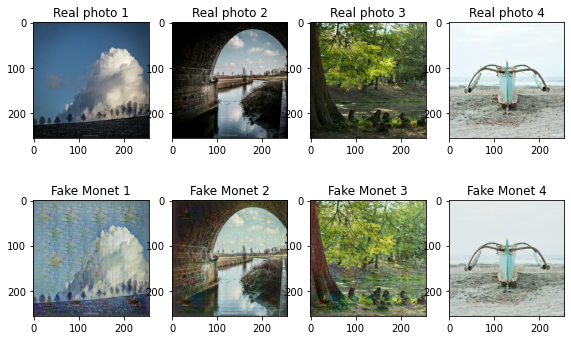

Epoch 20/20
296/296 [==============================] - 218s 737ms/step - monet_head_loss1: 0.9556 - monet_head_loss2: 0.6879 - disc_real_monet: 0.0935 - disc_fake_monet: -0.0150 - disc_real_monet2: -0.0274 - disc_fake_monet2: 0.0230 - monet_gen_loss: 0.2910 - photo_disc_loss: 0.8801
5 generated examples


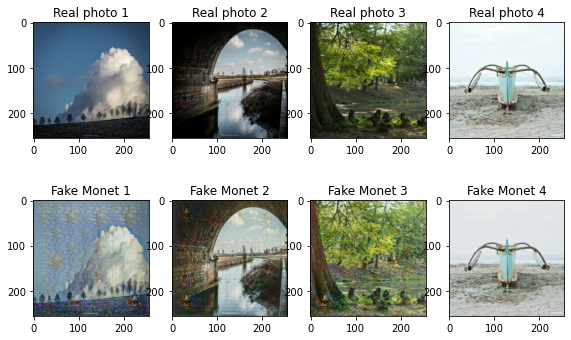

In [40]:
cycle_gan_model.fit(final_dataset,steps_per_epoch=296, epochs=20,callbacks=ShowExamples())


In [42]:
monet_generator.save_weights("diff_aug.h5")
#photo_generator.save_weights('diff_aug_p.h5')

In [32]:

monet_generator.built=True
monet_generator.load_weights('diff_aug.h5')

k


## Plotting photo to monet

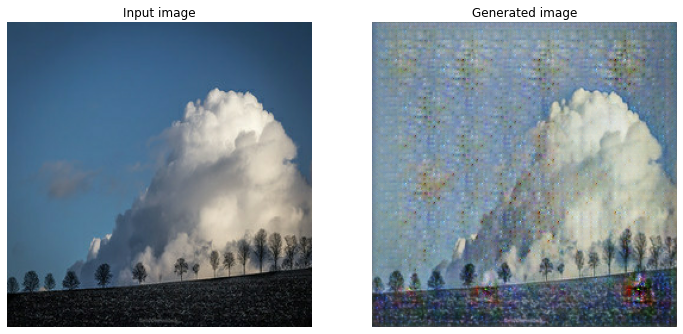

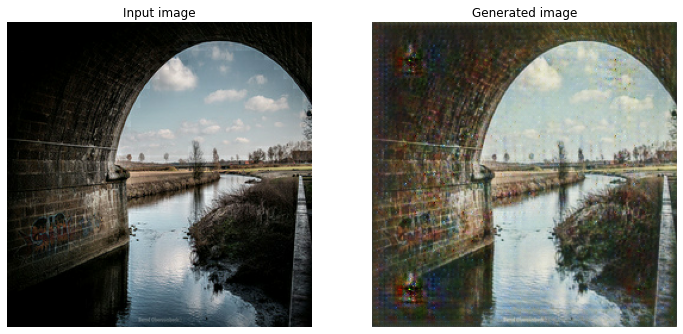

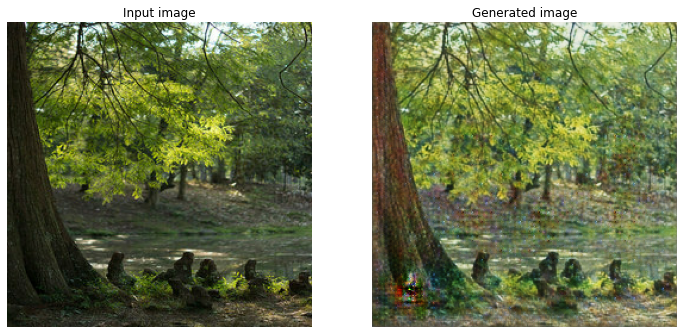

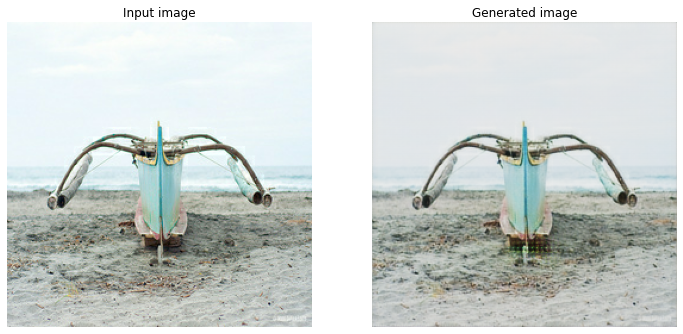

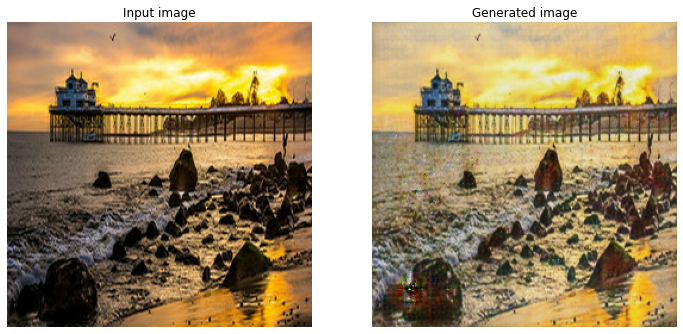

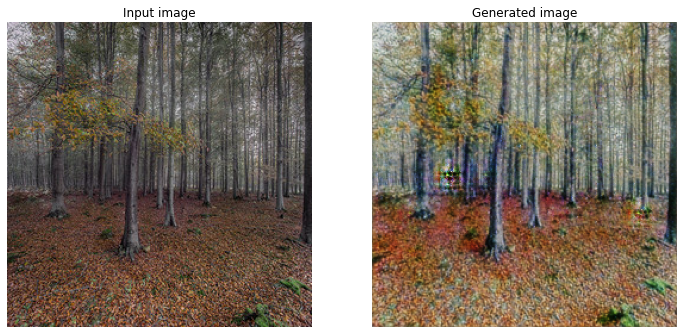

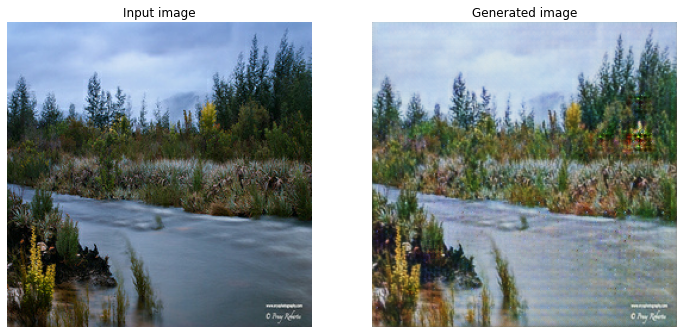

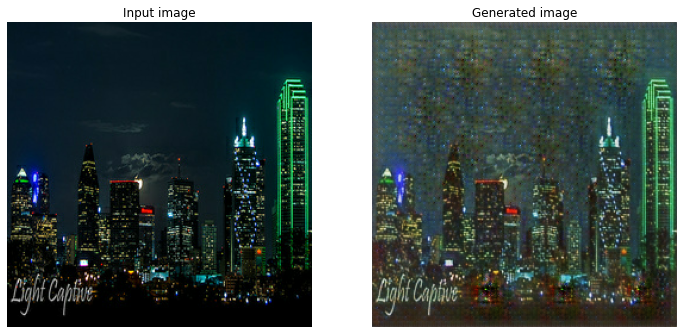

In [35]:
ds_iter = iter(photo_ds)
for n_sample in range(8):
        example_sample = next(ds_iter)
        generated_sample = monet_generator(example_sample)
        
        f = plt.figure(figsize=(12, 12))
        
        plt.subplot(121)
        plt.title('Input image')
        plt.imshow(example_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        
        plt.subplot(122)
        plt.title('Generated image')
        plt.imshow(generated_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        plt.show()

## Plotting monet to photo ( I forgot to save the weights for the monet-to-photo model)

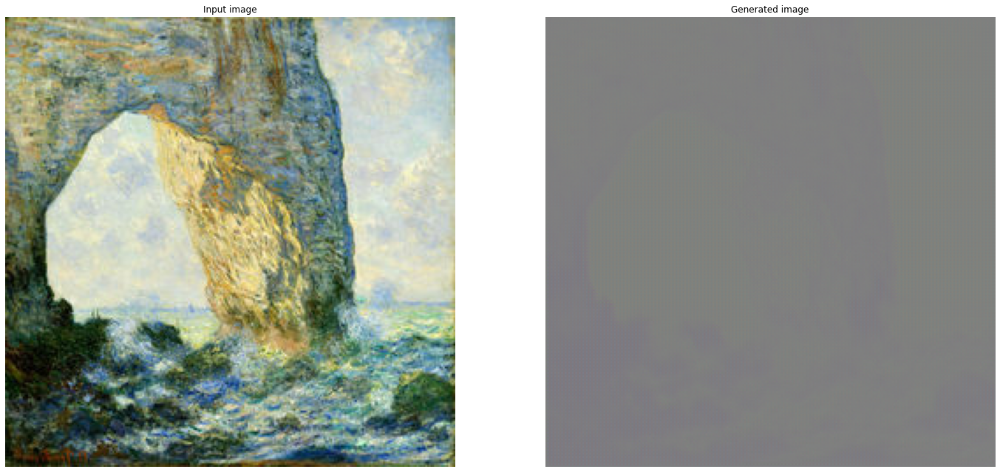

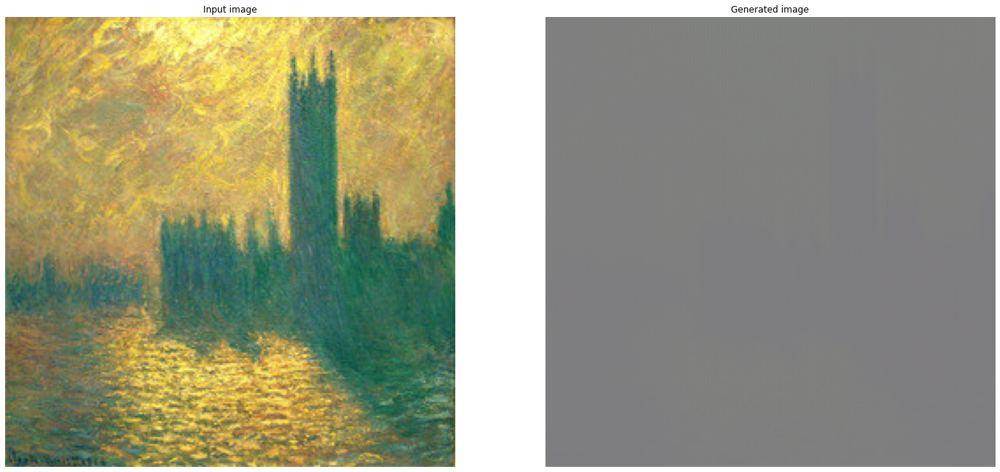

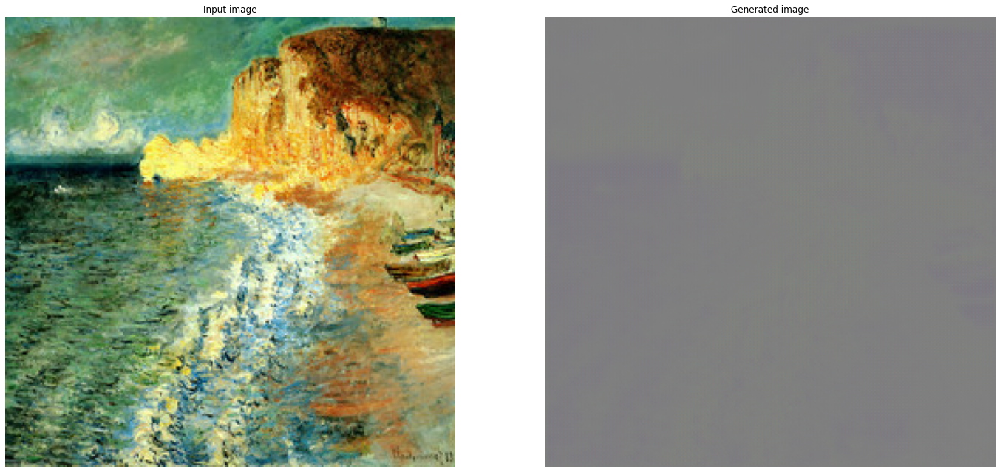

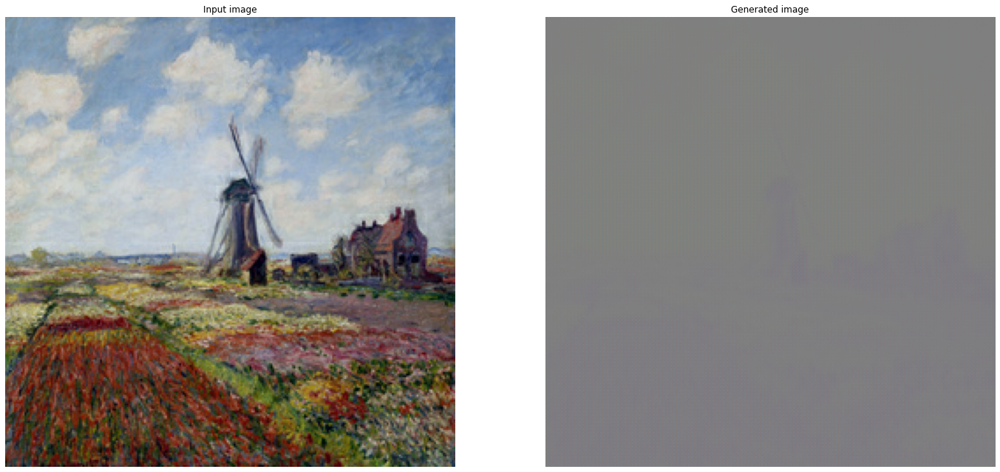

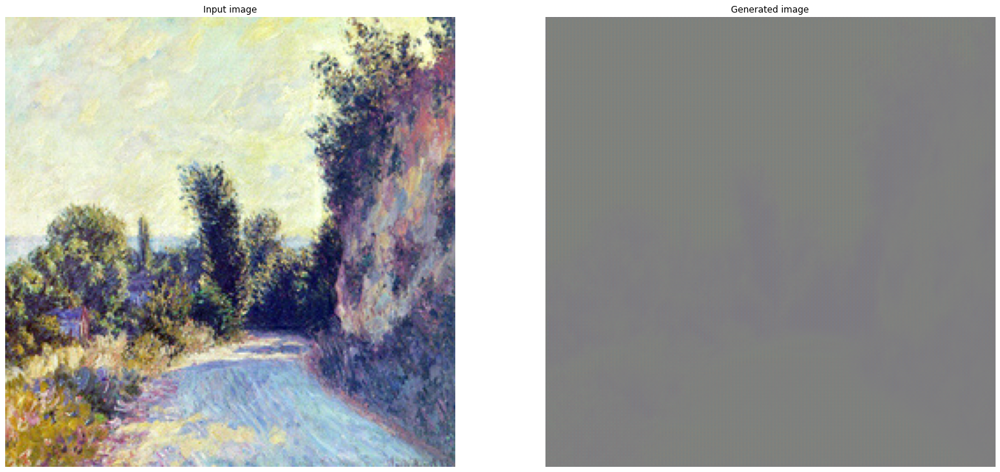

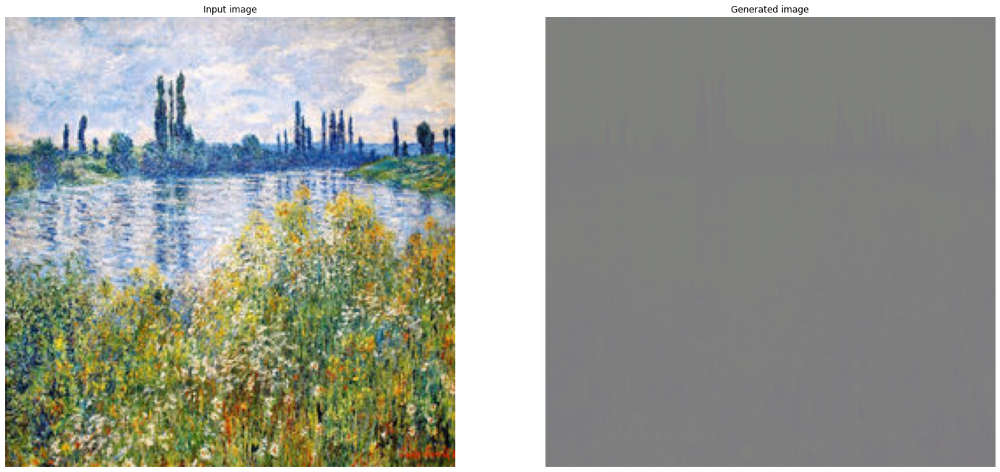

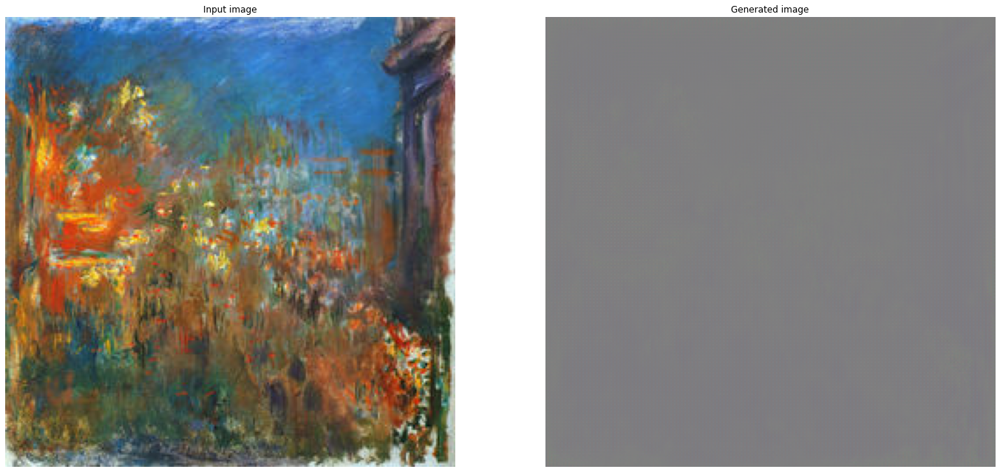

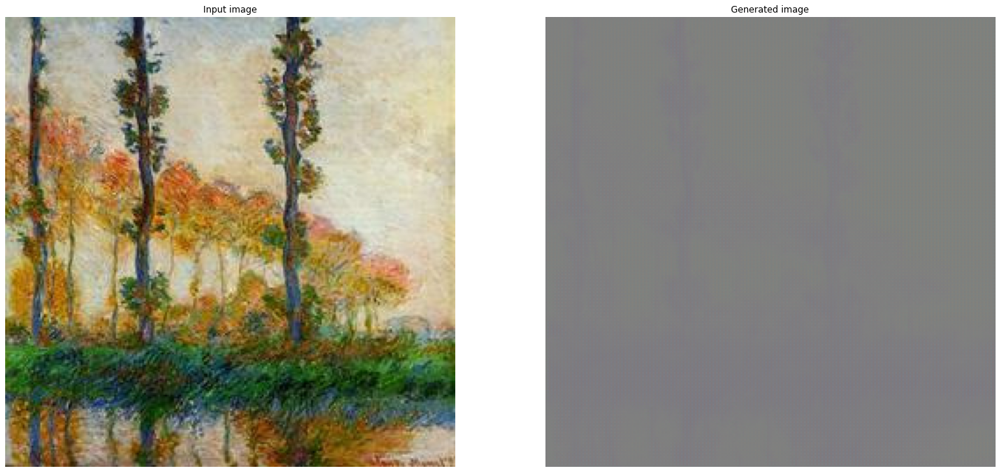

In [34]:
ds_iter = iter(monet_ds)
for n_sample in range(8):

        example_sample = next(ds_iter)
        generated_sample = photo_generator(example_sample)
        
        f = plt.figure(figsize=(24, 24))
        
        plt.subplot(121)
        plt.title('Input image')
        plt.imshow(example_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        
        plt.subplot(122)
        plt.title('Generated image')
        plt.imshow(generated_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        plt.show()

In [35]:
import PIL
! mkdir ../images

In [36]:
%%time
i = 1
for img in fast_photo_ds:
    prediction = monet_generator(img, training=False).numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    for pred in prediction:
        im = PIL.Image.fromarray(pred)
        im.save("../images/" + str(i) + ".jpg")
        i += 1
    

CPU times: user 31.2 s, sys: 13.3 s, total: 44.5 s
Wall time: 4min 7s


In [37]:
import shutil
shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

'/kaggle/working/images.zip'

In [38]:
# cycle_gan_model.p_gen.save_weights("p_gen_weights.h5")
# monet_generator.save_weights("monet_generator.h5")

# cycle_gan_model.p_disc.save_weights("p_disc_weights.h5")
# cycle_gan_model.m_disc.save_weights("m_disc_weights.h5")